<a href="https://colab.research.google.com/github/valebl/AP_exam/blob/master/Focal_mechanism.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.cluster import DBSCAN
%config InlineBackend.figure_format = 'svg'
%matplotlib inline
from PIL import Image

In [2]:
filepath_UTM32N = "/content/drive/MyDrive/SeismicSources/CATALOGUE.xlsx"
df = pd.read_excel(filepath_UTM32N,usecols="A:N",engine="openpyxl")
print(df.head(10))
df.set_index('Index',inplace=True)
df = df[['X','Y','MwDef','Year','LonDef','LatDef','EqID']]
df = df.dropna(axis=0,how='any')
print(df.head(10))


   Index  Year    Mo  ...             X             Y               EqID
0      0  1005   NaN  ...  7.331372e+05  4.816379e+06  10050000_0000_000
1      1  1005   NaN  ...  9.033421e+05  4.604211e+06  10050000_0000_001
2      2  1019   4.0  ...  9.850866e+05  4.569418e+06  10190401_0000_000
3      3  1044   4.0  ...  9.850866e+05  4.569418e+06  10440419_0900_000
4      4  1046  11.0  ...  0.000000e+00  0.000000e+00  10461109_0000_000
5      5  1065   3.0  ...  5.952487e+05  5.043553e+06  10650327_1125_000
6      6  1065   3.0  ...  0.000000e+00  0.000000e+00  10650327_1645_000
7      7  1087   9.0  ...  1.160782e+06  4.583025e+06  10870910_0000_000
8      8  1091   1.0  ...  7.884312e+05  4.644411e+06  10910127_0000_000
9      9  1094   1.0  ...  9.850866e+05  4.569418e+06  10940114_0000_000

[10 rows x 14 columns]
                  X             Y  MwDef  ...  LonDef  LatDef               EqID
Index                                     ...                                   
0      7.33

## Italy shape file

In [3]:
zones = []
with open('/content/drive/MyDrive/SeismicSources/Italia2.txt') as f:
    lines = f.read()
    for zone in lines.split(';'):
        zones.append(zone)
for i in range(len(zones)):
    zones[i] = zones[i].split('\n')
    for j in range(len(zones[i])):
        zones[i][j] = zones[i][j].split(',')
    if [''] in zones[i]:
        zones[i].remove([''])
for i in range(len(zones)):
    for j in range(len(zones[i])):
        if '' in zones[i][j]:
            zones[i][j].remove('')
        if zones[i][j] == []:
            del zones[i][j]
            continue
        for k in range(len(zones[i][j])):
            zones[i][j][k] = float(zones[i][j][k])

In [4]:
def plot_italy():
    j = 0
    for zone in zones:
        x_zone = [zone[i][0] for i in range(len(zone)) if i > 0]
        y_zone = [zone[i][1] for i in range(len(zone)) if i > 0]
        plt.plot(x_zone, y_zone, 'k', alpha=1, linewidth=0.3)
        j += 1

## Haversine distance

In [5]:
def haversine_np(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)

    All args must be of equal length.    

    """
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    km = 6367 * c
    return km

## Known focal mechanisms

In [6]:
# Import RCMT
filepath = "/content/drive/MyDrive/SeismicSources/EuroMedCentrMomTensors.xlsx"
df_RCMT = pd.read_excel(filepath,usecols="A,BD,BE,BF")

df_RCMT['ev_id'] = df_RCMT['ev_id'].apply(lambda x: x[1:])

df['EqID'] = df['EqID'].apply(lambda x: x[0:8] + x[9:13] + 'A' if x[14:17]=='000' else x[0:8] + x[9:13] + 'B')

dip = ['NaN' for x in range(len(df))]
rake = ['NaN' for x in range(len(df))]
strike = ['NaN' for x in range(len(df))]
faulting_style = ['NaN' for x in range(len(df))]

first_event = df_RCMT['ev_id'].values[7] # this is the first event in RCMT that is also in CPTI!
position = np.where(df['EqID'] == first_event)
position = (int(position[0]))

for i in range(position, len(df)):
    idx = np.where(df_RCMT['ev_id'] == df['EqID'].values[i])
    idx = idx[0]
    if idx.size > 0:
        dip[i] = df_RCMT['dip1'].values[idx][0]
        rake[i] = df_RCMT['rake1'].values[idx][0]
        strike[i] = df_RCMT['strike1'].values[idx][0]

Determine the focal mechanism based on rake and dip values.

In [7]:
delta_dip = 20
delta_rake = 0

for i in range(position, len(df)):
    if dip[i] != 'NaN':
        dipi = dip[i]
        strikei = strike[i]
        rakei = rake[i]

        # if dipi >= 90 - delta_dip and dipi <= 90 + delta_dip:
        if (rakei >= -45 and rakei <= 45) and (dipi >= 90 - delta_dip and dipi <= 90 + delta_dip):
            faulting_style[i] = 'SS'
        elif (rakei >= -180 and rakei <= -135) and (dipi >= 90 - delta_dip and dipi <= 90 + delta_dip):
            faulting_style[i] = 'SS'
        elif (rakei >= 135 and rakei <= 180) and (dipi >= 90 - delta_dip and dipi <= 90 + delta_dip):
            faulting_style[i] = 'SS'          
        elif rakei < 0:
            faulting_style[i] = 'N'
        else:
            faulting_style[i] = 'R'

Add the faulting style to the catalogue.

In [8]:
df['faulting_style'] = faulting_style
print(df.head(10))

                  X             Y  MwDef  ...  LatDef           EqID  faulting_style
Index                                     ...                                       
0      7.331372e+05  4.816379e+06   4.86  ...  43.464  100500000000A             NaN
1      9.033421e+05  4.604211e+06   5.10  ...  41.488  100500000000B             NaN
2      9.850866e+05  4.569418e+06   4.63  ...  41.131  101904010000A             NaN
3      9.850866e+05  4.569418e+06   4.63  ...  41.131  104404190900A             NaN
5      5.952487e+05  5.043553e+06   5.10  ...  45.539  106503271125A             NaN
7      1.160782e+06  4.583025e+06   4.86  ...  41.129  108709100000A             NaN
8      7.884312e+05  4.644411e+06   5.10  ...  41.899  109101270000A             NaN
9      9.850866e+05  4.569418e+06   4.63  ...  41.131  109401140000A             NaN
10     6.580732e+05  5.014586e+06   6.52  ...  45.267  111701031515A             NaN
12     9.112262e+05  4.592288e+06   5.80  ...  41.377  1120032500

Install a package to easily print the beachballs.

In [9]:
#!pip install obspy
from obspy.imaging.beachball import beachball
from obspy.imaging.beachball import beach

In [10]:
N = [90, 45, -90]
SS = [180, 90, 1]
R = [90, 45, 90]

fig, ax = plt.subplots(1,figsize=(10,10))

plot_italy()

for i in range(position,len(df)):
    f_style = df['faulting_style'].values[i]
    x = df['LonDef'].values[i]
    y = df['LatDef'].values[i]
    dipi = dip[i]
    strikei = strike[i]
    rakei = rake[i]
    if f_style == 'N':
        color = 'b'
    elif f_style == 'SS':
        color = 'y'
    elif f_style == 'R':
      color = 'r'
    else:
        continue
    bb = beach([strikei, dipi, rakei], xy=(x, y), linewidth=0.3, width=0.3, facecolor=color) 
    ax.add_collection(bb)

ax.set_xlim((5, 20))
ax.set_ylim((34, 48))
plt.show()
fig.savefig("/content/drive/MyDrive/SeismicSources/test_RCMT.png")

## Wells and Coppersmith 1994

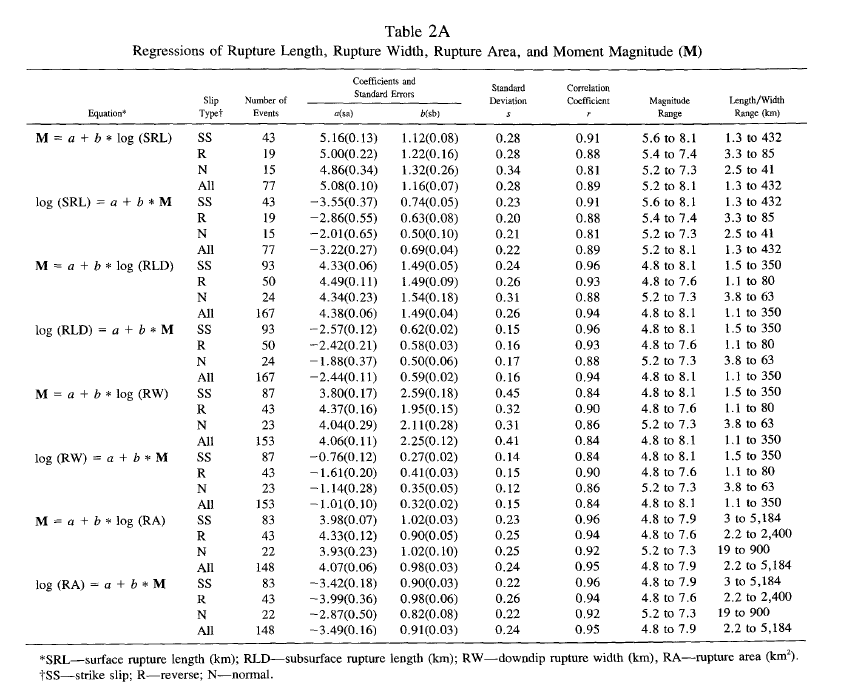

In [11]:
def SRL(M):
    '''Surface Rupture Length (km)'''
    a = -3.22
    b = 0.69
    SRL_log10 = a + b * M
    return 10**SRL_log10

def RW(M):
    '''Rupture Width (km)'''
    a = -1.01
    b = 0.32
    RW_log10 = a + b * M
    return 10**RW_log10

Add dip, rake and strike values for the events that do not have the information, based on the mean of the events that fall in a radius of mean(SRL, RW), calculated based on the magnitude of the event of interest. Only the event for which the information was available a priori are considered in the computation.

In [12]:
LONG_ALL = df['LonDef'].values
LAT_ALL = df['LatDef'].values

DISTANCES = [haversine_np(lon, lat, LONG_ALL, LAT_ALL) for lon, lat in zip(LONG_ALL,LAT_ALL)]

for i in range(len(df)):
    f_style = df['faulting_style'].values
    Mw = df['MwDef'].values[i]
    if f_style[i] == 'NaN':
        SLRi = SRL(Mw)
        RWi = RW(Mw)
        DIST = [DISTANCES[i][j]  if f_style[j] != "NaN" else np.inf for j in range(len(DISTANCES[i]))]
        radius = max((SLRi + RWi)/2, min(DIST))
        idx_neighbours = [j for j in  range(len(DISTANCES[i])) if DIST[j] <= radius]
        dipi = np.mean([dip[k] for k in idx_neighbours])
        rakei = np.mean([rake[k] for k in idx_neighbours])
        strikei = np.mean([strike[k] for k in idx_neighbours])
        dip[i] = dipi
        rake[i] = rakei
        strike[i] = strikei

In [13]:
delta_dip = 20
delta_rake = 0

faulting_style_upd = faulting_style

for i in range(len(df)):
    if dip[i] != 'NaN':
        dipi = dip[i]
        strikei = strike[i]
        rakei = rake[i]

        # if dipi >= 90 - delta_dip and dipi <= 90 + delta_dip:
        if (rakei >= -45 and rakei <= 45) and (dipi >= 90 - delta_dip and dipi <= 90 + delta_dip):
            faulting_style[i] = 'SS'
        elif (rakei >= -180 and rakei <= -135) and (dipi >= 90 - delta_dip and dipi <= 90 + delta_dip):
            faulting_style[i] = 'SS'
        elif (rakei >= 135 and rakei <= 180) and (dipi >= 90 - delta_dip and dipi <= 90 + delta_dip):
            faulting_style[i] = 'SS'          
        elif rakei < 0:
            faulting_style[i] = 'N'
        else:
            faulting_style[i] = 'R'

In [14]:
df['faulting_style_upd'] = faulting_style_upd

In [ ]:
fig, ax = plt.subplots(1,figsize=(10,10))

plot_italy()

for i in range(len(df)):
    f_style = df['faulting_style_upd'].values[i]
    x = df['LonDef'].values[i]
    y = df['LatDef'].values[i]
    dipi = dip[i]
    strikei = strike[i]
    rakei = rake[i]
    if f_style == 'N':
        color = 'b'
    elif f_style == 'SS':
        color = 'y'
    elif f_style == 'R':
      color = 'r'
    else:
        continue
    bb = beach([strikei, dipi, rakei], xy=(x, y), linewidth=0.3, width=0.3, facecolor=color) 
    ax.add_collection(bb)

ax.set_xlim((5, 20))
ax.set_ylim((34, 48))
plt.show()
fig.savefig("/content/drive/MyDrive/SeismicSources/test.png")

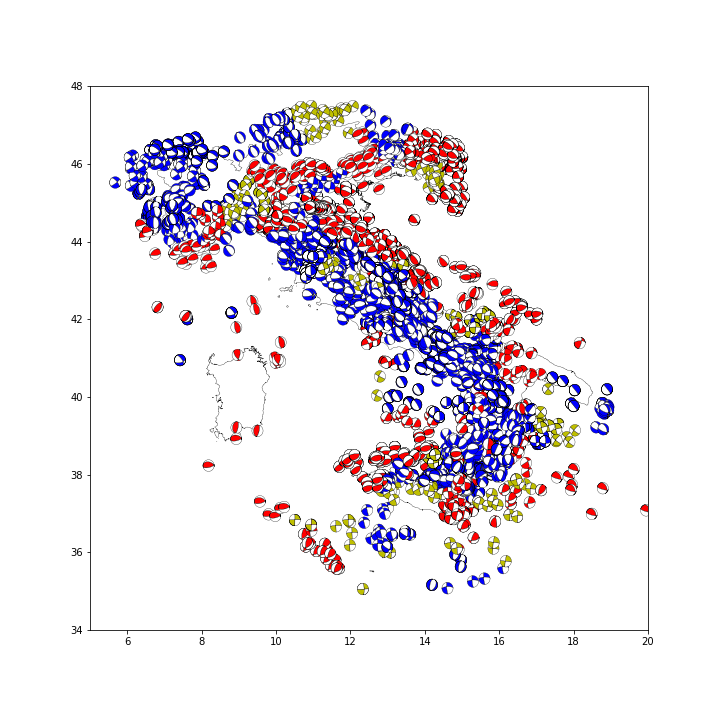

In [17]:
Image.open("/content/drive/MyDrive/SeismicSources/test.png")

In [19]:
df['dip'] = dip
df['rake'] = rake
df['strike'] = strike

In [20]:
df.head(10)

,X,Y,MwDef,Year,LonDef,LatDef,EqID,faulting_style,faulting_style_upd,dip,rake,strike
Index,,,,,,,,,,,,
0,7.331372e+05,4.816379e+06,4.86,1005,11.882,43.464,100500000000A,NaN,N,21.0,-72.0,358.0
1,9.033421e+05,4.604211e+06,5.10,1005,13.831,41.488,100500000000B,NaN,N,9.0,-157.0,271.0
2,9.850866e+05,4.569418e+06,4.63,1019,14.778,41.131,101904010000A,NaN,N,27.0,-110.0,280.0
3,9.850866e+05,4.569418e+06,4.63,1044,14.778,41.131,104404190900A,NaN,N,27.0,-110.0,280.0
5,5.952487e+05,5.043553e+06,5.10,1065,10.220,45.539,106503271125A,NaN,R,25.0,92.0,235.0
7,1.160782e+06,4.583025e+06,4.86,1087,16.869,41.129,108709100000A,NaN,R,55.0,149.0,267.0
8,7.884312e+05,4.644411e+06,5.10,1091,12.477,41.899,109101270000A,NaN,N,48.0,-20.0,205.0
9,9.850866e+05,4.569418e+06,4.63,1094,14.778,41.131,109401140000A,NaN,N,27.0,-110.0,280.0
10,6.580732e+05,5.014586e+06,6.52,1117,11.015,45.267,111701031515A,NaN,N,66.0,-170.0,107.0


In [24]:
rake_360 = [r if r > 0 else r + 360 for r in rake]

In [25]:
df['rake_360'] = rake_360

In [26]:
# Write the dataframe object into csv file
df.to_excel("/content/drive/MyDrive/SeismicSources/CATALOGUE_FOCAL.xlsx", header=True)